# Global Life Expectency Trends: Exploratory Data Analysis

<br>

<a id="Introduction"></a>

## 1. Introduction

The objective of this Exploratory Data Analysis (EDA) is to explore and understand the trends and patterns in global life expectancy using data from the [World Bank Group](https://data.worldbank.org/indicator/SP.DYN.LE00.IN?end=2022&start=2022&view=bar). The datasets sourced from the World Bank Group provides comprehensive health-related indicators, including life expectancy, across various countries and regions from 1960 to 2023 for male, female, and total populations. This analysis aims to address several key questions related to life expectancy trends, gender differences, regional disparities, and significant changes over time.

#### Research Questions
- **Overall Trends:**
    - What are the global trends in life expectancy from 1960 to 2022? 
    - This question seeks to identify whether life expectancy has generally increased, decreased, or remained stable over the years.

- **Gender Differences:** 
    - How does life expectancy differ between males and females? 
    - This analysis will explore gender-specific trends and highlight any significant disparities.

- **Regional Disparities:** 
    - Which countries or regions exhibit the highest and lowest life expectancy? 
    - This question aims to identify geographical areas with notable life expectancy figures and explore potential reasons for these differences.

- **Significant Changes:** 
    - Are there any significant changes or trends in life expectancy during specific periods? 
    - This involves identifying periods of rapid change or stability and understanding the factors contributing to these trends.
    
- **Comparison to Global Averages:** 
    - How does life expectancy in different regions compare to global averages? 
    - This analysis will compare regional data to global benchmarks to assess relative performance.

#### Purpose and Importance
Understanding life expectancy trends is crucial for public health planning and policy-making. By analyzing this data, stakeholders can identify areas needing intervention, allocate resources effectively, and track progress towards health-related goals. This analysis provides valuable insights into the trends regarding life expectancy and helps inform strategies to improve health outcomes globally.

<br>

<a id="Data-Overview"></a>

## 2. Data Overview


#### Data Acquisition

The data provided by the World Bank Group can be accessed through their official data hub or viewed online at the link provided below:
- [Download Data](https://api.worldbank.org/v2/en/indicator/SP.DYN.LE00.IN?downloadformat=excel)

- [Online Data](https://data.worldbank.org/indicator/SP.DYN.LE00.IN)

#### Key Features of the Dataset

- **Indicator Name**: Represents the specific life expectancy measure (e.g., life expectancy at birth for males, females, or both).

- **Country Name**: The geographical location from which the data is collected.

- **1960 - 2023**: Yearly data columns indicating the life expectancy calculated for each year.

<br>

<a id="Data-Initial-Exploration"></a>

## 3. Initial Data Exploration

In this section, the necessary libraries and datasets needed for analysis will be imported and initialized.

The following libraries are used:
- Library `pandas` will be required to work with data in tabular representation.

- Library `numpy` will be required to round the numerical data.

- Library `scipy` will be required to visualize statistical values in the data.

- Library `matplotlib`, `seaborn`, `plotly` will be required for data visualization.

- Library `country_converter` provides predefined lists of countries grouped by various criteria.


In [1]:
# Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import pandas as pd
import plotly.express as px
import plotly.io as pio
import logging
import warnings
import country_converter as coco
%matplotlib inline

# Settings
sns.set_theme(style="darkgrid")
pd.set_option('display.max_rows', 10)
pio.renderers.default = 'notebook'

# Set up logging
coco_logger = logging.getLogger('country_converter')
coco_logger.setLevel(logging.ERROR)
warnings.filterwarnings("ignore", category=RuntimeWarning)
warnings.filterwarnings("ignore", category=FutureWarning)

The information regarding life expectancy by sex (male, female, both) is imported from three separate Excel sheets and then combined into a single DataFrame for further analysis using `pandas`.

In [2]:
# Import data and save it as DataFrame
df_total = pd.read_excel('../data/total_le.xlsx', sheet_name="Data")
df_male = pd.read_excel('../data/male_le.xlsx', sheet_name='Data')
df_female = pd.read_excel('../data/female_le.xlsx', sheet_name='Data')
df_data = pd.concat([df_total, df_male, df_female])

# Display the DataFrame
df_data.head(2)

,Country Name,Country Code,Indicator Name,Indicator Code,1960,1961,1962,1963,1964,1965,...,2014,2015,2016,2017,2018,2019,2020,2021,2022,2023
0,Aruba,ABW,"Life expectancy at birth, total (years)",SP.DYN.LE00.IN,64.152000,64.537000,64.752000,65.13200,65.294000,65.50200,...,75.601000,75.683000,75.617000,75.90300,76.072000,76.248000,75.723000,74.626000,74.992000,NaN
1,Africa Eastern and Southern,AFE,"Life expectancy at birth, total (years)",SP.DYN.LE00.IN,44.098835,44.401083,44.768037,44.92569,45.498933,45.51282,...,61.338813,61.856856,62.444641,62.92481,63.367037,63.754752,63.309794,62.449093,62.888463,NaN


In [3]:
# Dimensions of the data
print(f'The data contains {df_data.shape[0]} records and {df_data.shape[1]} columns.')

# Datatypes of the data
print(f'\nThe data contains the following data types: \n{df_data.dtypes.value_counts()}')

The data contains 798 records and 68 columns.

The data contains the following data types: 
float64    64
object      4
Name: count, dtype: int64


<br>

<a id="Data-Cleaning"></a>

## 4. Data Cleaning and Preprocessing

In this section, data pre-processing will be conducted by examining data types, addressing missing values, removing duplicates, analyzing measures of central tendency, and extracting features.

### 4.1 Missing Values

In [4]:
# Initialize a list to store the results
missing_vals = []

# Check percentage of missing data
for col in df_data.columns:
    pct_missing = df_data[col].isnull().mean()
    missing_vals.append(f'{col} - {pct_missing:.0%}')

# Join the results into a single string and print
print(', '.join(missing_vals))

Country Name - 0%, Country Code - 0%, Indicator Name - 0%, Indicator Code - 0%, 1960 - 5%, 1961 - 5%, 1962 - 5%, 1963 - 5%, 1964 - 5%, 1965 - 5%, 1966 - 5%, 1967 - 5%, 1968 - 5%, 1969 - 5%, 1970 - 5%, 1971 - 5%, 1972 - 5%, 1973 - 5%, 1974 - 5%, 1975 - 5%, 1976 - 5%, 1977 - 5%, 1978 - 4%, 1979 - 5%, 1980 - 4%, 1981 - 4%, 1982 - 4%, 1983 - 4%, 1984 - 4%, 1985 - 4%, 1986 - 4%, 1987 - 4%, 1988 - 4%, 1989 - 4%, 1990 - 3%, 1991 - 3%, 1992 - 3%, 1993 - 3%, 1994 - 3%, 1995 - 3%, 1996 - 3%, 1997 - 3%, 1998 - 3%, 1999 - 3%, 2000 - 3%, 2001 - 3%, 2002 - 3%, 2003 - 3%, 2004 - 3%, 2005 - 3%, 2006 - 3%, 2007 - 3%, 2008 - 3%, 2009 - 3%, 2010 - 3%, 2011 - 3%, 2012 - 3%, 2013 - 3%, 2014 - 3%, 2015 - 3%, 2016 - 3%, 2017 - 3%, 2018 - 3%, 2019 - 3%, 2020 - 3%, 2021 - 3%, 2022 - 3%, 2023 - 100%


As all values for the year `2023` are missing, the entire column should be removed.

In [5]:
# Drop redundant columns
df_copy = df_data.copy()
df_copy = df_copy.drop(['2023'], axis=1)

When addressing missing values in a dataset covering multiple years, such as from `1960` to `2023`, interpolation can be employed to estimate these missing values by utilizing surrounding data points. Linear interpolation is particularly effective for continuous data, where a smooth transition between values is anticipated.

In [6]:
# Select only numeric columns (years)
numeric_cols = df_copy.select_dtypes(include=[np.number]).columns

# Perform interpolation on numeric columns to fill missing values
df_copy[numeric_cols] = df_copy[numeric_cols].interpolate(method='linear')

# Check for missing data
missing_data = df_copy.isna().sum()
print("Amount of missing data: ", missing_data.sum())

Amount of missing data:  0


**CONCLUSION:**

The dataset contains no missing values, so no additional modifications are needed.

### 4.2 Duplicates

The data can be reduced or simplified by identifying and removing duplicate entries.

In [7]:
# Check for duplicates in columns
duplicate_vals = []

for col in df_copy:
    if df_copy[col].duplicated().any() == True:
        duplicate_vals.append(f'Column {col} contains duplicates.')
    else:
        duplicate_vals.append(f'Column {col} contains no duplicates.')

# Join the results into a single string and print
print(', '.join(duplicate_vals))

Column Country Name contains duplicates., Column Country Code contains duplicates., Column Indicator Name contains duplicates., Column Indicator Code contains duplicates., Column 1960 contains duplicates., Column 1961 contains duplicates., Column 1962 contains duplicates., Column 1963 contains duplicates., Column 1964 contains duplicates., Column 1965 contains duplicates., Column 1966 contains duplicates., Column 1967 contains duplicates., Column 1968 contains duplicates., Column 1969 contains duplicates., Column 1970 contains duplicates., Column 1971 contains duplicates., Column 1972 contains duplicates., Column 1973 contains duplicates., Column 1974 contains duplicates., Column 1975 contains duplicates., Column 1976 contains duplicates., Column 1977 contains duplicates., Column 1978 contains duplicates., Column 1979 contains duplicates., Column 1980 contains duplicates., Column 1981 contains duplicates., Column 1982 contains duplicates., Column 1983 contains duplicates., Column 1984 

It is understandable that there may be duplicate values in the dataset, as fields like `Year`, `Location`, and `Indicator` are often repeated. Therefore, there is no need to remove these duplicates. However, it is important to check the data for anomalies, such as spelling errors, inconsistent casing, or typing mistakes.

In [8]:
# Strip whitespace and trailing spaces
for col in df_copy:
    if df_copy[col].dtype == 'object':
        print(f'Before Stripping {col}: {len(set(df_copy[col]))} After Stripping {col}: {len(set(df_copy[col].str.title().str.strip()))}')

Before Stripping Country Name: 266 After Stripping Country Name: 266
Before Stripping Country Code: 266 After Stripping Country Code: 266
Before Stripping Indicator Name: 3 After Stripping Indicator Name: 3
Before Stripping Indicator Code: 3 After Stripping Indicator Code: 3


As the `Indicator Code` and `Country Code` columns are not significant for the analysis, they can be replaced with `Country Name` and `Indicator Name`, and thus, can be removed.

In [9]:
# Drop redundant columns
df_copy = df_copy.drop(['Indicator Code', 'Country Code'], axis=1)

# Check DataFrame
df_copy.head(2)

,Country Name,Indicator Name,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,"Life expectancy at birth, total (years)",64.152000,64.537000,64.752000,65.13200,65.294000,65.50200,66.063000,66.439000,...,75.636000,75.601000,75.683000,75.617000,75.90300,76.072000,76.248000,75.723000,74.626000,74.992000
1,Africa Eastern and Southern,"Life expectancy at birth, total (years)",44.098835,44.401083,44.768037,44.92569,45.498933,45.51282,45.263398,45.933042,...,60.710028,61.338813,61.856856,62.444641,62.92481,63.367037,63.754752,63.309794,62.449093,62.888463


The data must be reviewed for unique values, taking into account typographical errors, spelling mistakes, and variations in the strings provided.

It is common for the same country to be listed with slight differences in spelling or formatting (for example, "USA," "U.S.A.," and "United States"). Conducting a frequency analysis can help identify these variations by highlighting multiple entries that should correspond to a single entity. To detect these anomalies, it is necessary to count the frequency of each entry.

In [10]:
# Frequency analysis
country_counts = df_copy['Country Name'].value_counts()
display(country_counts)

Country Name
Zimbabwe                       3
Aruba                          3
Africa Eastern and Southern    3
Afghanistan                    3
Africa Western and Central     3
                              ..
Austria                        3
Australia                      3
Antigua and Barbuda            3
American Samoa                 3
Armenia                        3
Name: count, Length: 266, dtype: int64

**CONCLUSION:** 

Each dataset entry returned a frequency that appears three times, indicating valid duplicates exist for life expectancy of males, females, and both across regions. Therefore, no further data transformation is necessary.

### 4.3 Transformation

In [11]:
# Check column data type
df_copy.iloc[:, :5].info()

<class 'pandas.core.frame.DataFrame'>
Index: 798 entries, 0 to 265
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Country Name    798 non-null    object 
 1   Indicator Name  798 non-null    object 
 2   1960            798 non-null    float64
 3   1961            798 non-null    float64
 4   1962            798 non-null    float64
dtypes: float64(3), object(2)
memory usage: 37.4+ KB


Data types classified as `object` typically consume more memory than other data types, which can result in delays during program execution. Consequently, these data types are good candidates for conversion to `categorical`. A categorical variable has a limited and often fixed number of possible values. Examples include gender, social class, blood type, country affiliation, observation time, or ratings using Likert scales.

In [12]:
# Convert object dtype columns to category dtype
for col in df_copy.select_dtypes(include=['object']).columns:
    df_copy[col] = df_copy[col].astype('category')

# Verify the conversion
df_copy.iloc[:, :5].info()

<class 'pandas.core.frame.DataFrame'>
Index: 798 entries, 0 to 265
Data columns (total 5 columns):
 #   Column          Non-Null Count  Dtype   
---  ------          --------------  -----   
 0   Country Name    798 non-null    category
 1   Indicator Name  798 non-null    category
 2   1960            798 non-null    float64 
 3   1961            798 non-null    float64 
 4   1962            798 non-null    float64 
dtypes: category(2), float64(3)
memory usage: 37.6 KB


In [13]:
# Check DataFrame
df_copy.head(2)

,Country Name,Indicator Name,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Aruba,"Life expectancy at birth, total (years)",64.152000,64.537000,64.752000,65.13200,65.294000,65.50200,66.063000,66.439000,...,75.636000,75.601000,75.683000,75.617000,75.90300,76.072000,76.248000,75.723000,74.626000,74.992000
1,Africa Eastern and Southern,"Life expectancy at birth, total (years)",44.098835,44.401083,44.768037,44.92569,45.498933,45.51282,45.263398,45.933042,...,60.710028,61.338813,61.856856,62.444641,62.92481,63.367037,63.754752,63.309794,62.449093,62.888463


**CONCLUSION:** 

All data are in the correct types and formats; therefore, no further data transformation is needed.

### 4.4 Feature Engineering

Sorting the columns by `Country Name` will facilitate analysis and improve readability.

In [14]:
# Sort the DataFrame by 'Country Name' in descending order
df_copy = df_copy.sort_values(by='Country Name', ascending=True).reset_index(drop=True)
df_copy.head(2)

,Country Name,Indicator Name,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Afghanistan,"Life expectancy at birth, total (years)",32.535,33.068,33.547,34.016,34.494,34.953,35.453,35.924,...,62.417,62.545,62.659,63.136,63.016,63.081,63.565,62.575,61.982,62.879
1,Afghanistan,"Life expectancy at birth, male (years)",31.870,32.409,32.883,33.346,33.828,34.289,34.768,35.225,...,60.791,60.812,60.760,61.193,60.105,59.923,60.619,59.866,58.915,59.766


Rounding the numeric columns to whole numbers will make data easier to interpret and present. 

In [15]:
# Round life expectancy to 1 decimal place
df_copy = df_copy.round(1)
df_copy.head(2)

,Country Name,Indicator Name,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Afghanistan,"Life expectancy at birth, total (years)",32.5,33.1,33.5,34.0,34.5,35.0,35.5,35.9,...,62.4,62.5,62.7,63.1,63.0,63.1,63.6,62.6,62.0,62.9
1,Afghanistan,"Life expectancy at birth, male (years)",31.9,32.4,32.9,33.3,33.8,34.3,34.8,35.2,...,60.8,60.8,60.8,61.2,60.1,59.9,60.6,59.9,58.9,59.8


The `Indicator Name` column should only include data related to sex. Therefore, the values will be reformatted to enhance data readability. 

The conversions will be as follows:
- **Life expectancy at birth, total (years)**: Convert to "Total"

- **Life expectancy at birth, male (years)**: Convert to "Male"

- **Life expectancy at birth, female (years)**: Convert to "Female"

In [16]:
# Reformat row values
df_copy['Indicator Name'] = df_copy['Indicator Name'].cat.rename_categories({'Life expectancy at birth, female (years)' : "Female", 'Life expectancy at birth, male (years)' : "Male", 'Life expectancy at birth, total (years)' : "Total"})
df_copy['Indicator Name'] = df_copy['Indicator Name'].cat.remove_unused_categories()
df_copy.head(3)

,Country Name,Indicator Name,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Afghanistan,Total,32.5,33.1,33.5,34.0,34.5,35.0,35.5,35.9,...,62.4,62.5,62.7,63.1,63.0,63.1,63.6,62.6,62.0,62.9
1,Afghanistan,Male,31.9,32.4,32.9,33.3,33.8,34.3,34.8,35.2,...,60.8,60.8,60.8,61.2,60.1,59.9,60.6,59.9,58.9,59.8
2,Afghanistan,Female,33.3,33.8,34.3,34.8,35.2,35.7,36.2,36.7,...,64.0,64.3,64.6,65.1,66.1,66.5,66.7,65.4,65.3,66.2


Renaming columns to more descriptive names enhances the clarity and readability of the dataset, making it easier to understand and work with. 

The conversion will be as follows:
- **Indicator Name**: Rename to "Metric"

In [17]:
# Rename columns
df_copy = df_copy.rename(columns={'Indicator Name' : 'Metric'})
df_copy.head(2)

,Country Name,Metric,1960,1961,1962,1963,1964,1965,1966,1967,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
0,Afghanistan,Total,32.5,33.1,33.5,34.0,34.5,35.0,35.5,35.9,...,62.4,62.5,62.7,63.1,63.0,63.1,63.6,62.6,62.0,62.9
1,Afghanistan,Male,31.9,32.4,32.9,33.3,33.8,34.3,34.8,35.2,...,60.8,60.8,60.8,61.2,60.1,59.9,60.6,59.9,58.9,59.8


**CONCLUSION:** 

All essential data columns, formatting, and feature engineering have been applied; therefore, no further data transformation is necessary.

### 4.5 Outliers

Outliers can distort and mislead the analysis process, resulting in inaccurate predictions and insights. Therefore, addressing outliers is essential when preparing data for analysis or machine learning models. 

Generating summary statistics is a quick and effective way to assess whether a dataset contains outliers.

In [18]:
# Check summary statistics
df_copy.describe()

,1960,1961,1962,1963,1964,1965,1966,1967,1968,1969,...,2013,2014,2015,2016,2017,2018,2019,2020,2021,2022
count,798.000000,798.000000,798.000000,798.000000,798.000000,798.000000,798.000000,798.000000,798.000000,798.000000,...,798.000000,798.000000,798.000000,798.000000,798.000000,798.00000,798.000000,798.000000,798.000000,798.000000
mean,53.681830,54.257769,54.896617,55.267920,55.867920,56.138972,56.522055,56.944987,57.270050,57.516291,...,71.241604,71.520301,71.728446,72.029073,72.260777,72.49411,72.709900,72.077820,71.466541,72.172556
std,11.486171,11.267390,10.992561,10.971642,10.968187,10.990591,10.944280,10.891117,10.732879,10.725487,...,8.234501,8.185501,7.990993,7.880375,7.767343,7.68184,7.617909,7.579155,7.726192,7.765055
min,26.300000,26.600000,26.900000,25.800000,29.700000,26.400000,22.900000,23.200000,23.500000,22.800000,...,46.400000,47.400000,48.500000,49.600000,50.400000,51.00000,51.400000,51.200000,50.400000,50.300000
25%,44.100000,45.000000,46.025000,46.200000,47.100000,47.100000,47.700000,48.000000,48.400000,49.025000,...,65.325000,65.600000,65.925000,66.300000,66.725000,67.02500,67.500000,66.800000,66.100000,66.725000
50%,53.800000,54.200000,55.200000,55.850000,56.300000,56.950000,57.350000,57.900000,58.300000,58.600000,...,72.500000,72.800000,72.850000,73.100000,73.300000,73.50000,73.500000,72.650000,72.000000,72.900000
75%,63.875000,64.100000,64.275000,64.475000,65.100000,65.475000,65.800000,66.175000,66.225000,66.400000,...,77.775000,78.000000,78.100000,78.375000,78.400000,78.70000,78.800000,77.975000,77.200000,78.300000
max,75.900000,76.300000,76.200000,76.100000,76.400000,76.500000,76.700000,76.900000,76.800000,76.700000,...,86.800000,86.800000,87.300000,87.300000,87.600000,87.60000,88.100000,87.800000,87.900000,88.000000


The data from the years show consistent results throughout the summary, with no significant variations from the mean or standard deviation. As a result, it is challenging to identify outliers based solely on the summary statistics. To further analyze this, we can employ statistical measures such as calculating the Z-score and the Interquartile Range (IQR).

In addition, the IQR method, along with visualizations such as box plots, can be utilized to further analyze whether outliers exist.

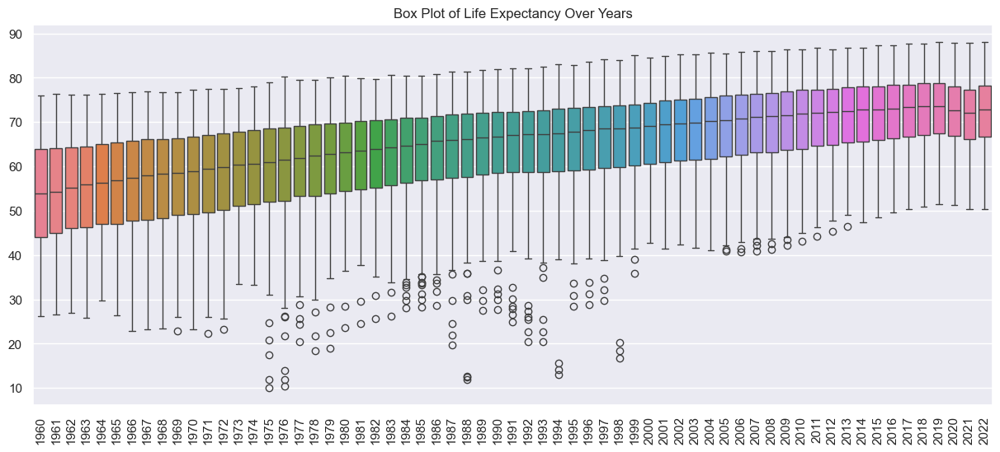

In [19]:
# Visualize with a box plot for all years
plt.figure(figsize=(15, 6))
sns.boxplot(data=df_copy.loc[:, df_copy.columns.str.isnumeric()])
plt.title('Box Plot of Life Expectancy Over Years')
plt.xticks(rotation=90)
plt.show()

In [20]:
# Identify outliers using Z-score for all years
numeric_cols = df_copy.columns[df_copy.columns.str.isnumeric()]
z_scores = np.abs(stats.zscore(df_copy[numeric_cols]))
outliers_z = (z_scores > 3)

# Identify outliers using IQR for all years
Q1 = df_copy[numeric_cols].quantile(0.25)
Q3 = df_copy[numeric_cols].quantile(0.75)
IQR = Q3 - Q1
outliers_iqr = (df_copy[numeric_cols] < (Q1 - 1.5 * IQR)) | (df_copy[numeric_cols] > (Q3 + 1.5 * IQR))

print("Outliers detected using Z-score:\n", outliers_z)
print("Outliers detected using IQR:\n", outliers_iqr)

Outliers detected using Z-score:
 [[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]]
Outliers detected using IQR:
       1960   1961   1962   1963   1964   1965   1966   1967   1968   1969  \
0    False  False  False  False  False  False  False  False  False  False   
1    False  False  False  False  False  False  False  False  False  False   
2    False  False  False  False  False  False  False  False  False  False   
3    False  False  False  False  False  False  False  False  False  False   
4    False  False  False  False  False  False  False  False  False  False   
..     ...    ...    ...    ...    ...    ...    ...    ...    ...    ...   
793  False  False  False  False  False  False  False  False  False  False   
794  False  False  False  False  False  False  False  Fa

**CONCLUSION:** 

The statistical results and the boxplot visualization indicate that there are a few outliers in the dataset.

In this context, the outliers may come from low-income countries, where the values could accurately represent life expectancy due to various socio-economic and health factors. Removing these outliers could result in the loss of valuable information about the conditions in these regions. Therefore, in this case, there is no need to remove the outliers.

### 4.6 Final Modifications

Before analysing the data, it is advisable to melt the dataframe to enhance readability and facilitate plotting later on. Melting transforms the dataset from a wide format into a long format. This transformation allows the year ranges from 1960 to 2022 to be consolidated into a single column labeled  `Years`.

In [21]:
# Melt the DataFrame for easier plotting
df_melted = df_copy.melt(id_vars=['Country Name', 'Metric'], var_name='Year', value_name='Life Expectancy')
df_melted['Year'] = df_melted['Year'].astype(int)
df_melted.head()

,Country Name,Metric,Year,Life Expectancy
0,Afghanistan,Total,1960,32.5
1,Afghanistan,Male,1960,31.9
2,Afghanistan,Female,1960,33.3
3,Africa Eastern and Southern,Total,1960,44.1
4,Africa Eastern and Southern,Male,1960,42.6


The data from the final DataFrame (`df_melted`) can be exported for future analysis.

In [22]:
# File names
csv_file = 'final_data.csv'
excel_file = 'final_data.xlsx'

# Export to CSV
try:
    df_melted.to_csv(csv_file, index=False)
    print(f"Data exported to {csv_file}")
except PermissionError as e:
    print(f"Permission error while writing to {csv_file}: {e}")

# Export to Excel
try:
    df_melted.to_excel(excel_file, index=False, sheet_name='Life Expectancy Data')
    print(f"Data exported to {excel_file}")
except PermissionError as e:
    print(f"Permission error while writing to {excel_file}: {e}")

Data exported to final_data.csv
Data exported to final_data.xlsx


A new dataset can also be created from `df_melted` to compare continental information.

In [23]:
# Initialize CountryConverter
cc = coco.CountryConverter()

# Convert country names to regions using a valid classification
df_melted['Region'] = cc.convert(names=df_melted['Country Name'], to='continent')

# Create a new DataFrame with the region column
df_with_regions = df_melted[['Country Name', 'Region', 'Metric', 'Year', 'Life Expectancy']]

In [24]:
# Remove invalid regions from melted df
df_with_regions = df_with_regions.copy()
df_with_regions.drop(df_with_regions[df_with_regions['Region'] == 'not found'].index, inplace = True)
df_with_regions.head()

,Country Name,Region,Metric,Year,Life Expectancy
0,Afghanistan,Asia,Total,1960,32.5
1,Afghanistan,Asia,Male,1960,31.9
2,Afghanistan,Asia,Female,1960,33.3
9,Albania,Europe,Female,1960,57.8
10,Albania,Europe,Male,1960,51.4


In [25]:
# Remove region from melted df
df_melted.drop(columns=['Region'], index=0, inplace=True)
df_melted.head()

,Country Name,Metric,Year,Life Expectancy
1,Afghanistan,Male,1960,31.9
2,Afghanistan,Female,1960,33.3
3,Africa Eastern and Southern,Total,1960,44.1
4,Africa Eastern and Southern,Male,1960,42.6
5,Africa Eastern and Southern,Female,1960,45.7


In [26]:
# File names
csv_file = 'final_regional_data.csv'
excel_file = 'final_regional_data.xlsx'

# Export to CSV
try:
    df_with_regions.to_csv(csv_file, index=False)
    print(f"Data exported to {csv_file}")
except PermissionError as e:
    print(f"Permission error while writing to {csv_file}: {e}")

# Export to Excel
try:
    df_with_regions.to_excel(excel_file, index=False, sheet_name='Life Expectancy Data')
    print(f"Data exported to {excel_file}")
except PermissionError as e:
    print(f"Permission error while writing to {excel_file}: {e}")

Data exported to final_regional_data.csv
Data exported to final_regional_data.xlsx


<br>

<a id="Univariate"></a>

## 5. Univariate Analysis

Each variable can be examined individually to understand its distribution, central tendency, and variability more clearly. This understanding is crucial for identifying the nature of the data, such as whether it is normally distributed or skewed, which is a crucial step in the data analysis process as it provides a comprehensive understanding of a single variable's purpose and characteristics. 

### 5.1 Categorical Values

In [27]:
# 'Country Name'
print("\nFrequency Table for the Country Name data: ")
display(df_melted['Country Name'].value_counts())


Frequency Table for the Country Name data: 


Country Name
Zimbabwe                       189
Zambia                         189
Africa Eastern and Southern    189
Africa Western and Central     189
Albania                        189
                              ... 
Aruba                          189
Armenia                        189
Argentina                      189
Arab World                     189
Afghanistan                    188
Name: count, Length: 266, dtype: int64

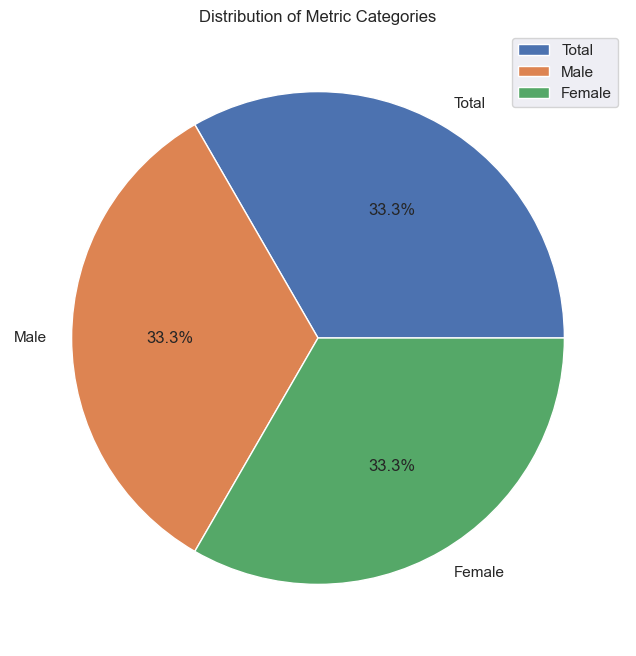

In [28]:
# 'Metric'
metric_col = df_melted['Metric'].value_counts()
plt.figure(figsize=(10,8))
plt.pie(metric_col, labels=['Total', 'Male', 'Female'], autopct='%1.1f%%')
plt.title("Distribution of Metric Categories")
plt.legend()
plt.show()

Region
Africa     10206
Asia        9450
Europe      8883
America     8694
Oceania     3591
Name: count, dtype: int64

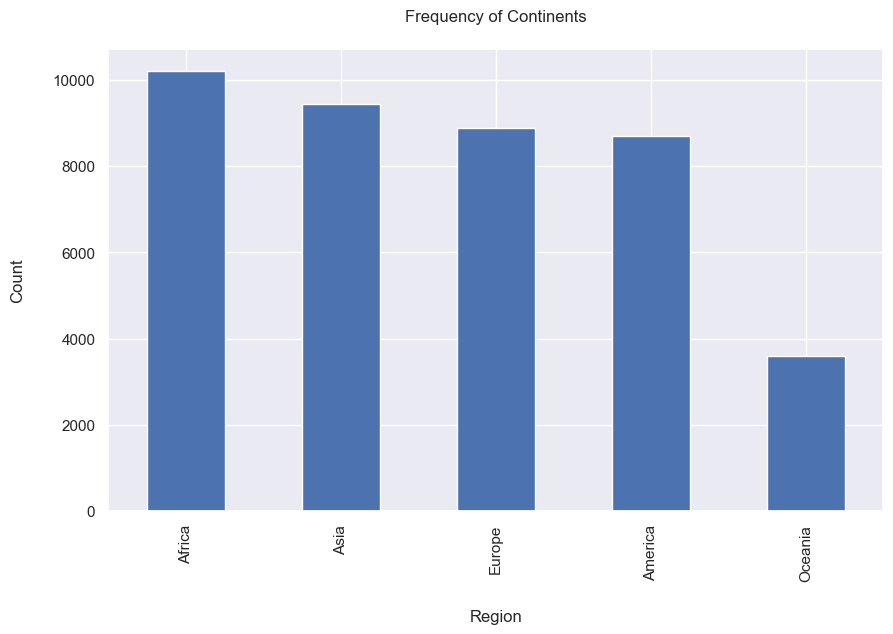

In [29]:
# 'Region'
region_counts = df_with_regions['Region'].value_counts()
display(region_counts)
plt.figure(figsize=(10, 6))
region_counts.plot(kind='bar')
plt.title('Frequency of Continents', pad=20)
plt.xlabel('Region', labelpad=20)
plt.ylabel('Count', labelpad=20)
plt.xticks(rotation=90)
plt.show()

**INSIGHTS:** 

**1. `Country Name`:**
- The frequency table indicates that each country or region listed has been counted 189 times in the dataset. 

- This uniform frequency suggests that the data might have been collected or structured to ensure equal representation of each country or region.

- This allows for unbiased comparisons of countries without unequal representation.

**2. `Metric`:**
- The pie chart shows that the Metric values are evenly distributed among Total, Male, and Female categories, with each representing 33.3% of the collected data. 

- This uniform distribution indicates that the data was gathered to ensure equal representation across each Metric.

- This means the variable will ensure gender balance in the analysis.

**3. `Region`:**
- As Africa is the largest continent, it logically has the highest value. In contrast, Oceania, being the smallest continent, has the lowest value. 

- The Americas (North and South) have been combined into a single total underneath 'America'. 

- Antarctica has been excluded due to low value counts or the lack of recording.

- This allows for unbiased comparisons of continents without unequal representation.

### 5.2 Numerical Values

Skew of Life Expectancy data is:  -0.573358807194973
Kurtosis of Life Expectancy data is:  -0.21093928703495068


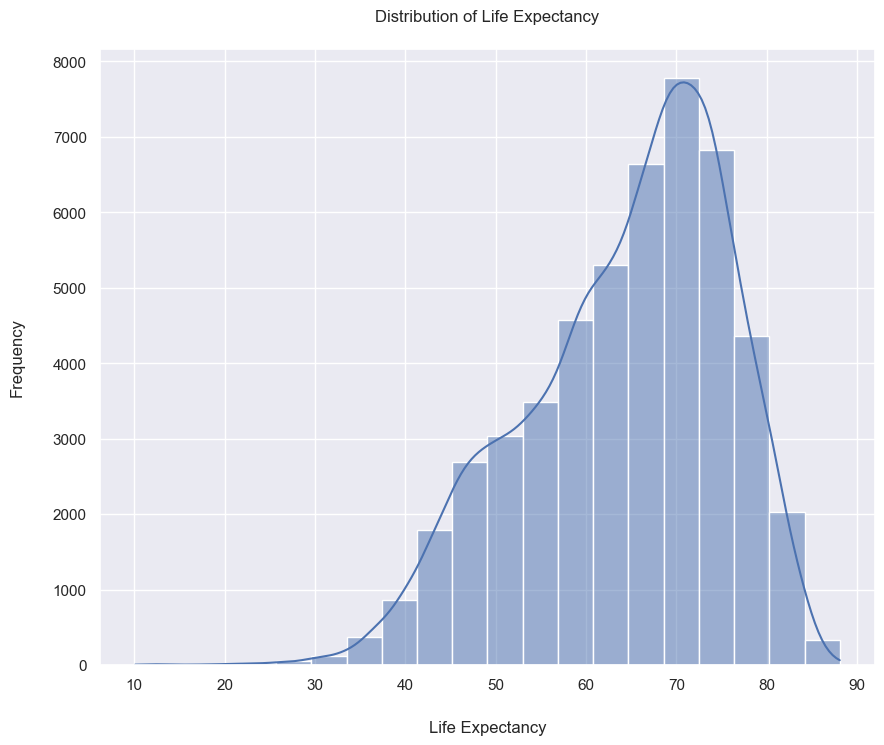

In [30]:
# 'Life Expectancy'
print("Skew of Life Expectancy data is: ", df_melted['Life Expectancy'].skew())
print("Kurtosis of Life Expectancy data is: ", df_melted['Life Expectancy'].kurtosis())

plt.figure(figsize=(10, 8))
sns.histplot(df_melted['Life Expectancy'], bins=20, kde=True)
plt.title('Distribution of Life Expectancy', pad=20)
plt.xlabel('Life Expectancy', labelpad=20)
plt.ylabel('Frequency', labelpad=20)
plt.show()

Frequency Table for the Year data:
 Year
1960    797
1961    798
1962    798
1963    798
1964    798
       ... 
2018    798
2019    798
2020    798
2021    798
2022    798
Name: count, Length: 63, dtype: int64


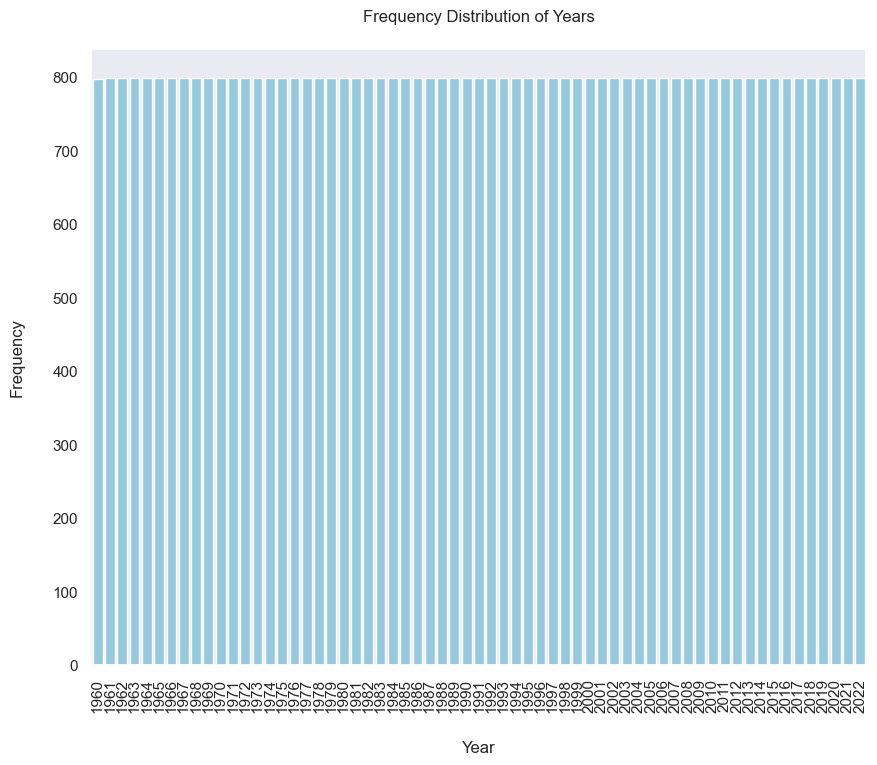

In [31]:
# 'Years'
year_counts = df_melted['Year'].value_counts().sort_index()
print("Frequency Table for the Year data:\n", year_counts)

# Bar plot for frequency distribution
plt.figure(figsize=(10, 8))
sns.barplot(x=year_counts.index, y=year_counts.values, color='skyblue')
plt.title('Frequency Distribution of Years', pad=20)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Frequency', labelpad=20)
plt.xticks(rotation=90)
plt.grid(axis='y')
plt.show()

**INSIGHTS:** 

**1. `Life Expectancy`:**
- Skewness measures the asymmetry of a distribution. The skewness value of -0.5735 indicates that the distribution of the Life Expectancy data is negatively skewed, or left-skewed. This is normal in datasets where there is a natural upper limit, such as life expectancy, where most values are clustered towards the higher end.

- Kurtosis measures the "tailedness" of a distribution. A kurtosis value of -0.2106 suggests that there are fewer extreme outliers than a normal distribution would have. This means that the data are more evenly distributed around the mean, with fewer extreme deviations.

- This means the variable contains values that are higher, with a few lower values pulling the mean to the left of the median.

**2. `Year`:**

- The frequency table shows that each year listed has been counted 798 times in the dataset. 

- This consistent frequency indicates that the data was collected to ensure equal representation of every year.

- This means the variable has uniformity, which is beneficial for longitudinal analysis as it allows for detailed, unbiased exploration of trends and causation over time.

<br>

<a id="Bivariate"></a>

## 6. Bivariate Analysis

The relationships between variables can be examined to uncover patterns, correlations, or associations. This will help determine whether there is a statistical relationship between two variables and, if so, the nature and strength of that relationship.

### 6.1 Numerical vs. Categorical

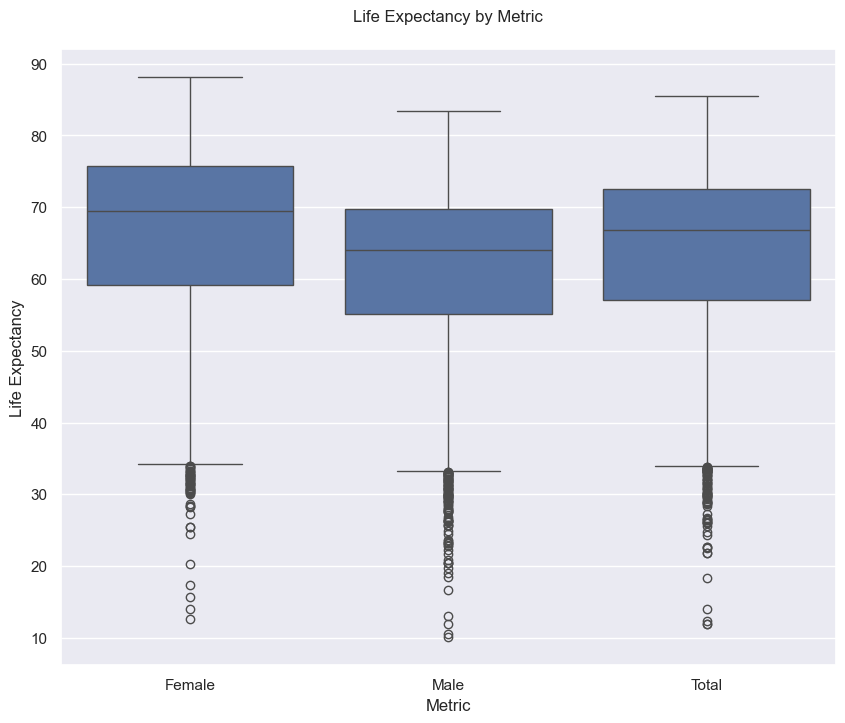

In [32]:
# 'Life Expectancy' by 'Metric'
plt.figure(figsize=(10, 8))
sns.boxplot(data=df_melted, x='Metric', y='Life Expectancy')
plt.title('Life Expectancy by Metric', pad=20)
plt.show()

**INSIGHTS:** 

**`Life Expectancy` vs. `Metric`:**
- Analysis of life expectancy across different metrics (Female, Male, Total) reveals that metric outliers are not merely anomalies but reflect underlying health, socio-economic, and environmental conditions.

- These outliers can highlight disparities in health outcomes between genders and point to areas where targeted interventions may be needed to address specific challenges, such as access to healthcare, nutrition, and living conditions.

- This relationship allows for further targeted strategies to improve health outcomes for underrepresented groups.

### 6.2 Numerical vs. Numerical

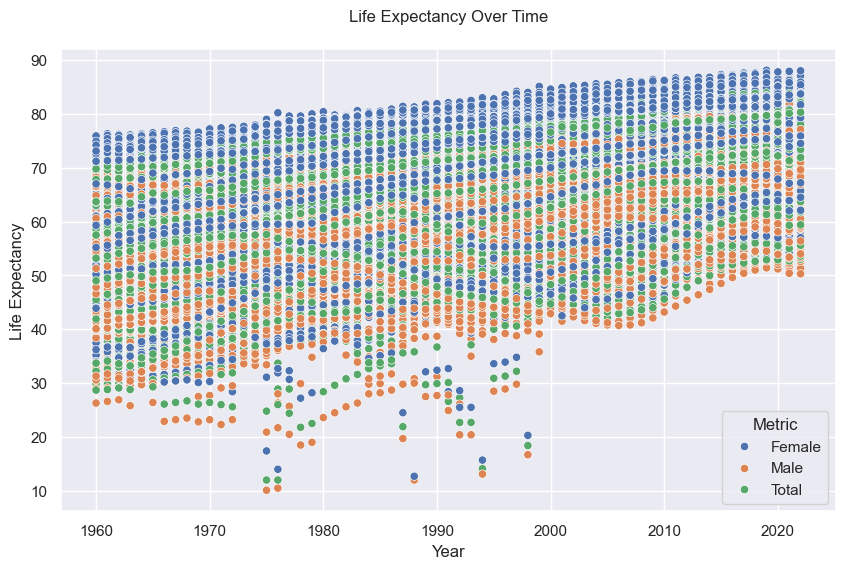

In [33]:
# 'Year' vs. 'Life Expectancy'
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df_melted, x='Year', y='Life Expectancy', hue='Metric')
plt.title('Life Expectancy Over Time', pad=20)
plt.show()

**INSIGHTS:** 

**`Year` vs. `Life Expectancy`:**
- The scatter plot demonstrates a clear upward trend in life expectancy over the years, with data points forming a positive linear cluster.

- This trend suggests a consistent improvement in global health outcomes over time. However, the presence of a few outliers indicates deviations from this trend, which may be attributed to specific socio-economic factors, such as economic downturns, conflicts, or health crises, affecting certain regions or periods.

- This relationship allows for futher investigation in these outliers, which can provide insights into specific events or conditions that affected life expectancy.

### 6.3 Categorical vs. Categorical

In [34]:
# 'Country Name' and 'Metric'
contingency_table = pd.crosstab(df_melted['Country Name'], df_melted['Metric'])
display(contingency_table)

Metric,Female,Male,Total
Country Name,,,
Afghanistan,63,63,62
Africa Eastern and Southern,63,63,63
Africa Western and Central,63,63,63
Albania,63,63,63
Algeria,63,63,63
...,...,...,...
West Bank and Gaza,63,63,63
World,63,63,63
"Yemen, Rep.",63,63,63


In [35]:
# 'Region' and 'Metric'
contingency_table = pd.crosstab(df_with_regions['Metric'], df_with_regions['Region'])
display(contingency_table)

Region,Africa,America,Asia,Europe,Oceania
Metric,,,,,
Female,3402,2898,3150,2961,1197
Male,3402,2898,3150,2961,1197
Total,3402,2898,3150,2961,1197


In [36]:
# 'Region' and 'Country Name'
contingency_table = pd.crosstab(df_with_regions['Country Name'], df_with_regions['Region'])
display(contingency_table)

Region,Africa,America,Asia,Europe,Oceania
Country Name,,,,,
Afghanistan,0,0,189,0,0
Albania,0,0,0,189,0
Algeria,189,0,0,0,0
American Samoa,0,0,0,0,189
Andorra,0,0,0,189,0
...,...,...,...,...,...
Virgin Islands (U.S.),0,189,0,0,0
West Bank and Gaza,0,0,189,0,0
"Yemen, Rep.",0,0,189,0,0


**INSIGHTS:** 

**1. `Country Name` vs. `Metric`:**
- The cross table analysis reveals that each country has a consistent number of entries (63) for each metric category (Female, Male, Total).

- This uniformity indicates that the dataset is complete and consistent across these dimensions, allowing for reliable comparisons and analyses of life expectancy by gender within each country.

- This relationship allows for more advanced analyses, such as comparing life expectancy trends across countries or examining gender disparities in health outcomes. 

**2. `Region` vs. `Metric`:**
- The cross table analysis shows a consistent number of entries for each gender metric (Female, Male, Total) across continents. 

- All metrics are spread equally across the continents, with no outliers present during data capture.

- This facilitates advanced analyses, including comparisons of life expectancy trends across continents and the examination of gender disparities in regional outcomes.

**3. `Region` vs. `Country Name`:**
- The cross-tabulation analysis shows each country has 89 consistent entries per continent or region, with accurate classifications.

- This consistency indicates a complete and reliable dataset, allowing for trustworthy comparisons of life expectancy by gender within each country.

- This relationship enables advanced analyses, such as comparing life expectancy trends across continents or examining health disparities.

<br>

<a id="Data-Exploration"></a>

## 7. Data Exploration & Visualization

In this section, we will analyze the data using visualizations to address the following questions:

- What are the overall trends in life expectancy over the years?
- How does life expectancy vary by gender?
- Which countries or regions have the highest and lowest life expectancy?
- Are there any significant changes or trends in life expectancy during specific time periods?
- How does life expectancy in different regions compare to global averages?

### 7.1. Overall Trends in Life Expectancy

***What are the overall trends in life expectancy over the years?***

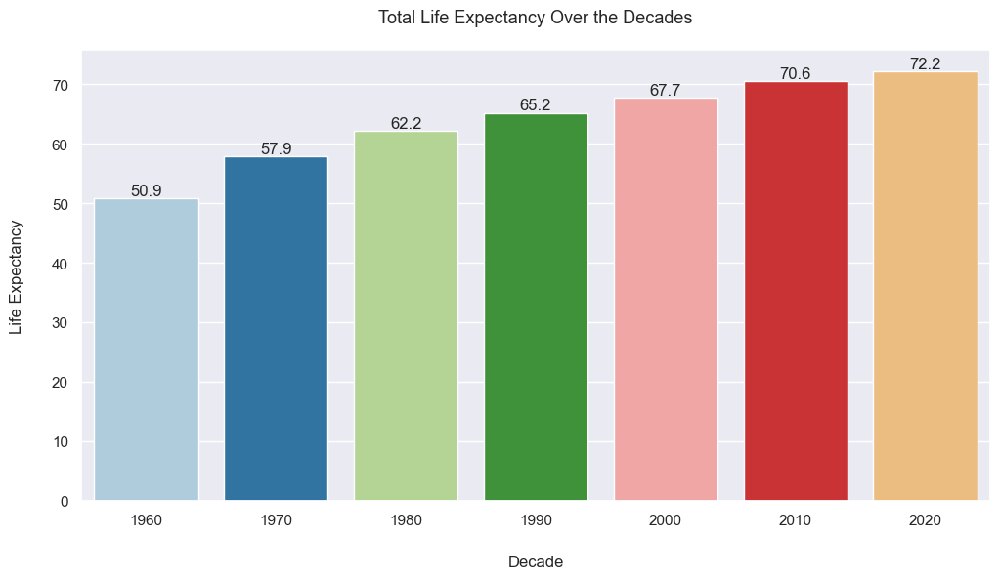

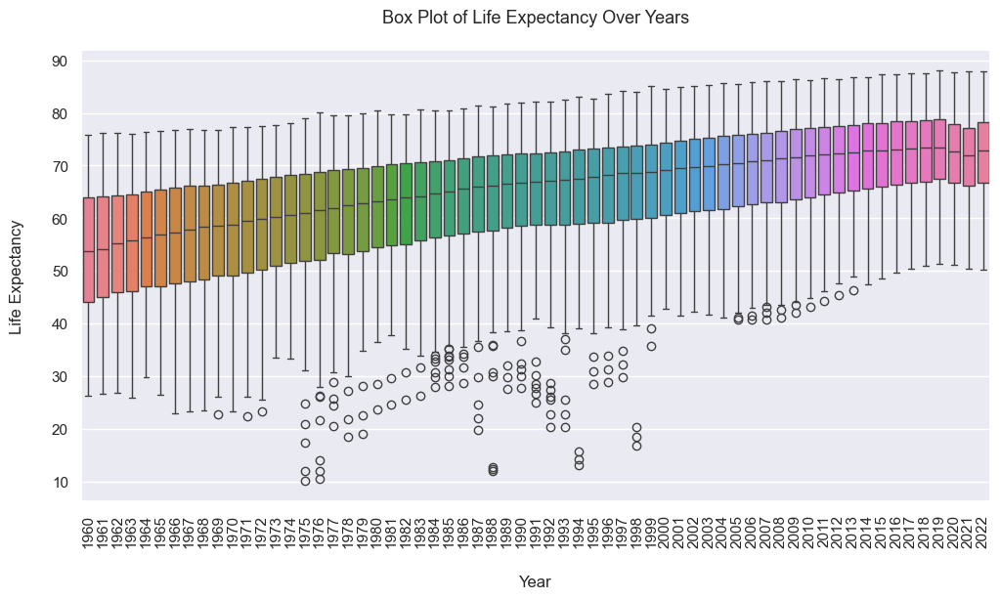

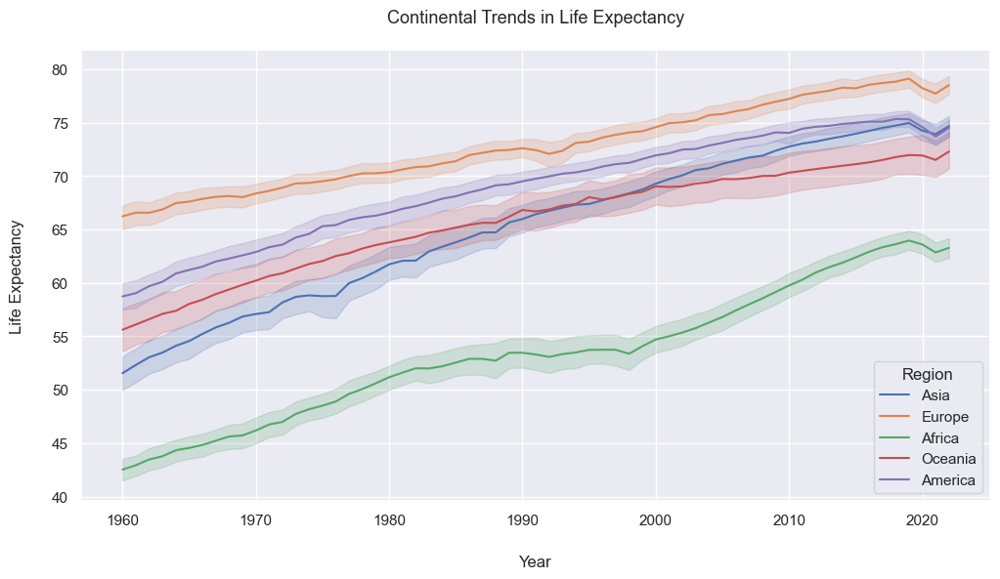

In [37]:
# VISUALIATION 1: Life Expectancy Trends Per Country
fig = px.line(df_melted[df_melted['Metric'] == 'Total'],
              x='Year',
              y='Life Expectancy',
              color='Country Name',
              title='Trends in Life Expectancy Over the Years')
fig.update_layout(
    dict(updatemenus=[
        dict(
            type = "buttons",
            direction = "left",
            buttons=list([
                dict(
                    args=["visible", "legendonly"],
                    label="Deselect All",
                    method="restyle"
                ),
                dict(
                    args=["visible", True],
                    label="Select All",
                    method="restyle"
                )
            ]),
            pad={"r": -180, "t": -20},
            showactive=False,
            x=1,
            xanchor="right",
            y=1.1,
            yanchor="top"
        ),
    ],
    height = 650,
    width = 1200,
    title={
        'x': 0.35,
        'xanchor': 'center'
    }
))
pio.show(fig)

# VISUALIATION 2: Life Expectancy Trends Over Decades
world_data = df_melted[(df_melted['Country Name'] == 'World') & (df_melted['Metric'] == 'Total')]
recent_year_data = world_data[world_data['Year'].isin([2020, 2010, 2000, 1990, 1980, 1970, 1960])]
plt.figure(figsize=(12, 6))
ax = sns.barplot(data=recent_year_data, x='Year', y='Life Expectancy', palette='Paired', hue='Year')
plt.title('Total Life Expectancy Over the Decades', fontsize=13, pad=20)
plt.xlabel('Decade', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
for bar in ax.patches:
    height = bar.get_height()
    if height != 0: 
        ax.annotate(f'{height:.1f}',
                    (bar.get_x() + bar.get_width() / 2, height),
                    ha='center', va='bottom')
plt.legend([],[], frameon=False)
plt.show()

# VISUALIATION 3: Boxplot Life Expectancy Trends Over Years
plt.figure(figsize=(12, 6))
ax = sns.boxplot(data=df_copy.loc[:, df_copy.columns.str.isnumeric()])
plt.title('Box Plot of Life Expectancy Over Years', pad=20, fontsize=13)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
plt.xticks(rotation=90)
plt.show()

# VISUALIATION 4: Continental Trends
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_with_regions, x='Year', y='Life Expectancy', hue='Region')
plt.title('Continental Trends in Life Expectancy', pad=20, fontsize=13)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
plt.legend(title='Region')
plt.show()

**INSIGHTS:** 

By analyzing the trends in life expectancy, it is determined:

- The average global life expectancy has been increasing over the decades.

- By 2020, life expectancy experienced a slight decline, likely due to the impact of the COVID-19 pandemic. However, it is beginning to stabilize and is rising again.

- From 1970 to 2000, there were many outliers in average life expectancy, primarily due to countries with lower socio-economic status. After 2000, the number of outliers decreased, indicating that life expectancy is gradually improving even in lower-income regions.

- This trend is evident in the continental statistics, with Africa having the lowest life expectancy but still showing a positive upward trend. The other continents generally exhibit high life expectancies, frequently overlapping during certain periods.

- Overall, there is a positive trend in life expectancy worldwide.

### 7.2. Life Expectancy by Gender Comparison

***How does life expectancy vary by gender?***

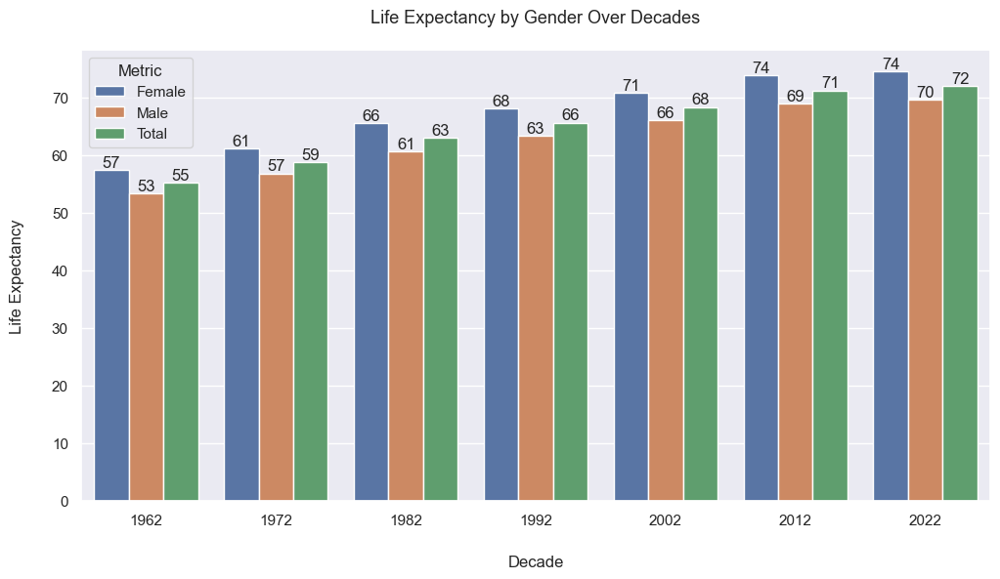

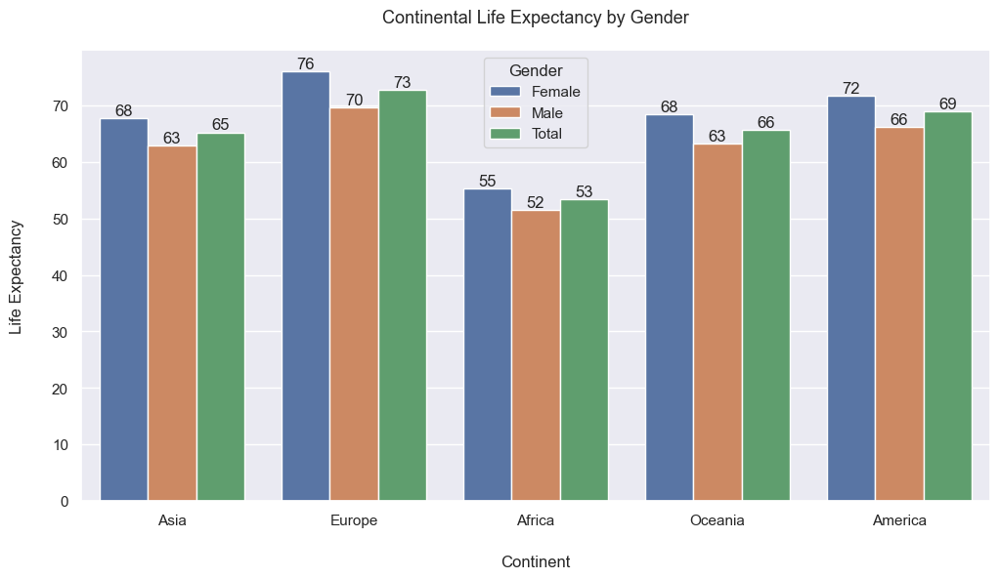

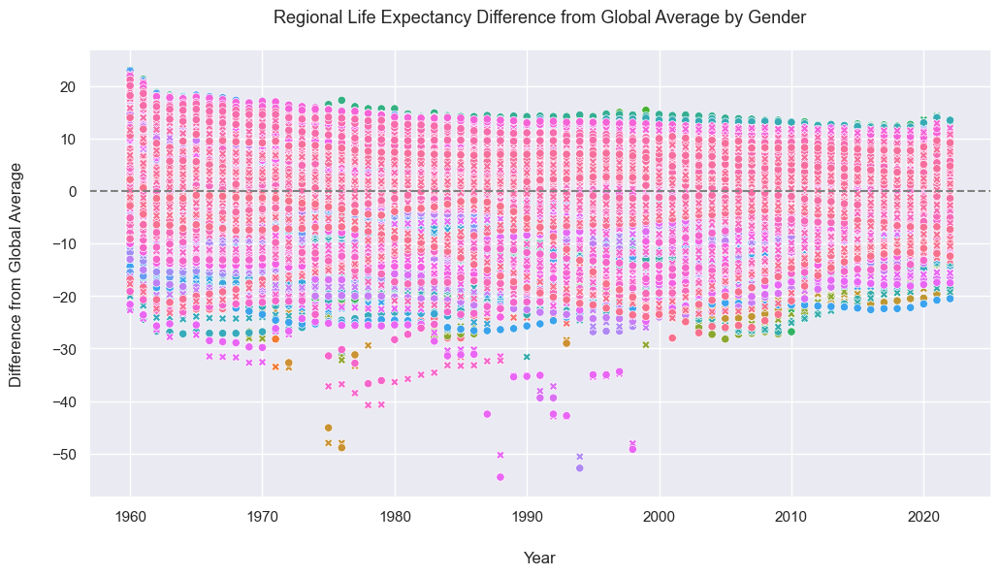

In [38]:
# VISUALIATION 1: Average Gender Trends
# Get data
world_data = df_melted[(df_melted['Country Name'] == 'World') & (df_melted['Metric'] != 'Total')]
# Plot live data
fig = px.line(world_data,
              x='Year',
              y='Life Expectancy',
              color='Metric',
              title='Average Life Expectancy by Gender Over the Years')
fig.update_layout(
    title={
        'x': 0.5,
        'xanchor': 'center'
    },
    width = 1000,
    showlegend=True
)
pio.show(fig)

# VISUALIATION 2: Decade Gender Differences
# Get data
world_data = df_melted[(df_melted['Country Name'] == 'World')]
recent_year_data = world_data[world_data['Year'].isin([2022, 2012, 2002, 1992, 1982, 1972, 1962])]
# Plot plot
plt.figure(figsize=(12, 6))
ax = sns.barplot(data=recent_year_data, x='Year', y='Life Expectancy', hue='Metric')
plt.title('Life Expectancy by Gender Over Decades', pad=20, fontsize=13)
plt.xlabel('Decade', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
for bar in ax.patches:
    height = bar.get_height()
    if height != 0: 
        ax.annotate(f'{height:.0f}',
                    (bar.get_x() + bar.get_width() / 2, height),
                    ha='center', va='bottom')
plt.show()

# VISUALIATION 3: Continental Gender Difference
plt.figure(figsize=(12, 6))
ax = sns.barplot(data=df_with_regions, x='Region', y='Life Expectancy', hue='Metric', errorbar=None)
plt.title('Continental Life Expectancy by Gender', pad=20, fontsize=13)
plt.xlabel('Continent', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
for bar in ax.patches:
    height = bar.get_height()
    if height != 0: 
        ax.annotate(f'{height:.0f}',
                    (bar.get_x() + bar.get_width() / 2, height),
                    ha='center', va='bottom')
plt.legend(title='Gender')
plt.show()

# VISUALIATION 4: Regional Gender Difference
# Get data
global_data = df_melted[(df_melted['Country Name'] == 'World') & (df_melted['Metric'].isin(['Male', 'Female']))]
regional_data = df_melted[(df_melted['Country Name'] != 'World') & (df_melted['Metric'].isin(['Male', 'Female']))]
merged_data = regional_data.merge(global_data[['Year', 'Metric', 'Life Expectancy']], on=['Year', 'Metric'], suffixes=('', '_Global'))
merged_data['Difference'] = merged_data['Life Expectancy'] - merged_data['Life Expectancy_Global']
# Plot plot
plt.figure(figsize=(12, 6))
sns.scatterplot(data=merged_data, x='Year', y='Difference', hue='Country Name', style='Metric')
plt.title('Regional Life Expectancy Difference from Global Average by Gender', pad=20, fontsize=13)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Difference from Global Average', labelpad=20)
plt.axhline(0, color='gray', linestyle='--')
plt.legend(title='Country Name', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.legend([],[], frameon=False)
plt.show()

**INSIGHTS:** 

By analyzing trends in life expectancy by gender, we can conclude the following:
- Average life expectancy for all genders has been increasing over the decades.

- Both genders have the highest average life expectancy in Europe, while Africa has the lowest.

- Females have a higher life expectancy than both males and the overall average, even during periods of decline.

- On average, females live approximately five years longer than males in each decade, indicating that the difference, while notable, isn't as significant as it may seem.

- This suggests that while the gap is consistent, it may not be as large as some might perceive, offering a balanced view of gender differences.

###  7.3. Highest and Lowest Regional Life Expectancy

***Which countries or regions have the highest and lowest life expectancy?***

In [39]:
# VISUALIATION 1: Highest & Lowest
# Get data
year_data = df_melted[(df_melted['Year'] == 2022) & (df_melted['Metric'] == 'Total')]
highest_life_expectancy = year_data.loc[year_data['Life Expectancy'].idxmax()]
lowest_life_expectancy = year_data.loc[year_data['Life Expectancy'].idxmin()]
extremes_data = pd.DataFrame([highest_life_expectancy, lowest_life_expectancy])
# Plot live plot
fig = px.bar(extremes_data,
             x='Country Name',
             y='Life Expectancy',
             color='Country Name', 
             title='Highest and Lowest Life Expectancy in 2022',
             text='Life Expectancy')
fig.update_traces(texttemplate='%{text:.2f}', textposition='outside')
fig.update_layout(
    xaxis_title='Country',
    yaxis_title='Life Expectancy',
    showlegend=False,
    height=650,
    title={
        'x': 0.5,
        'xanchor': 'center'
    }
)
pio.show(fig)

In [40]:

# VISUALIATION 2: Highest & Lowest Trendline
# Get data
year_data = df_melted[(df_melted['Year'] == 2022) & (df_melted['Metric'] == 'Total')]
highest_life_expectancy = year_data.loc[year_data['Life Expectancy'].idxmax()]
lowest_life_expectancy = year_data.loc[year_data['Life Expectancy'].idxmin()]
highest_country = highest_life_expectancy['Country Name']
lowest_country = lowest_life_expectancy['Country Name']
historical_data = df_melted[(df_melted['Country Name'].isin([highest_country, lowest_country])) & 
                            (df_melted['Metric'] == 'Total')]
# Plot live plot
fig = px.line(historical_data,
              x='Year',
              y='Life Expectancy',
              color='Country Name',
              title='Trends of 2022 Countries with Highest and Lowest Life Expectancy')
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Life Expectancy',
    showlegend=True,
    height=800,
    title={
        'x': 0.5,
        'xanchor': 'center'
    }
)
pio.show(fig)

In [41]:

# VISUALIATION 3: Highest & Lowest Per Decade
# Get data
df_melted['Decade'] = (df_melted['Year'] // 10) * 10
highest_per_decade = df_melted.loc[df_melted.groupby('Decade')['Life Expectancy'].idxmax()]
lowest_per_decade = df_melted.loc[df_melted.groupby('Decade')['Life Expectancy'].idxmin()]
extremes_per_decade = pd.concat([highest_per_decade, lowest_per_decade])
# Plot live plot
fig = px.bar(extremes_per_decade,
             x='Decade',
             y='Life Expectancy',
             color='Country Name',
             hover_name='Country Name',
             title='Highest and Lowest Life Expectancy by Decade')
fig.update_traces(texttemplate='%{y:.2f}', textposition='outside')
fig.update_layout(
    xaxis_title='Decade',
    yaxis_title='Life Expectancy',
    showlegend=False,
    height = 450,
    title={
        'x': 0.5,
        'xanchor': 'center'
    }
)
pio.show(fig)

In [42]:
# VISUALIATION 4: Highest & Lowest Per Continent
# Get data
highest_per_decade = df_with_regions.loc[df_with_regions.groupby('Region')['Life Expectancy'].idxmax()]
lowest_per_decade = df_with_regions.loc[df_with_regions.groupby('Region')['Life Expectancy'].idxmin()]
extremes_per_decade = pd.concat([highest_per_decade, lowest_per_decade])
# Plot live plot
fig = px.bar(extremes_per_decade,
             x='Region',
             y='Life Expectancy',
             color='Country Name',
             hover_name='Country Name',
             title='Highest and Lowest Life Expectancy by Continent')
fig.update_traces(texttemplate='%{y:.2f}', textposition='outside')
fig.update_layout(
    xaxis_title='Continent',
    yaxis_title='Life Expectancy',
    showlegend=False,
    height = 450,
    title={
        'x': 0.5,
        'xanchor': 'center'
    }
)
pio.show(fig)

**INSIGHTS:** 

By examining the trends in life expectancy over time, several key observations emerge:

- Lesotho has consistently recorded the lowest average life expectancy among all countries for three decades, highlighting persistent socio-economic difficulties. Despite historically low life expectancy, Lesotho has made significant strides, with average life expectancy rising from 20 years in the 1990s to 50 years in the 2020s. This reflects progress in tackling health disparities.

- Since the 1980s, Asian countries, especially regions in China and Japan, have led in high life expectancy rates, surpassing European nations like Norway and Iceland. This trend is likely attributed to advancements in healthcare, nutrition, and lifestyle improvements.

- High life expectancy figures have remained relatively stable, consistently ranging between 75 and 88 years.

- Some countries remain extreme outliers, such as South Sudan with a life expectancy of 12 years and Cambodia at 10 years.

- In 2022, Chad had the lowest life expectancy at 53 years, while Macao, China, reached 85 years, marking a 46.38% difference. In 1960, Chad's life expectancy was 38.4 years compared to Macao's 65 years, indicating a 52.43% difference.

- These overall trends suggest that countries are slowly converging towards a more standardized life expectancy, although progress is gradual.

### 7.4. Significant Changes in Life Expectancy

***Are there any significant changes or trends in life expectancy during specific time periods?***

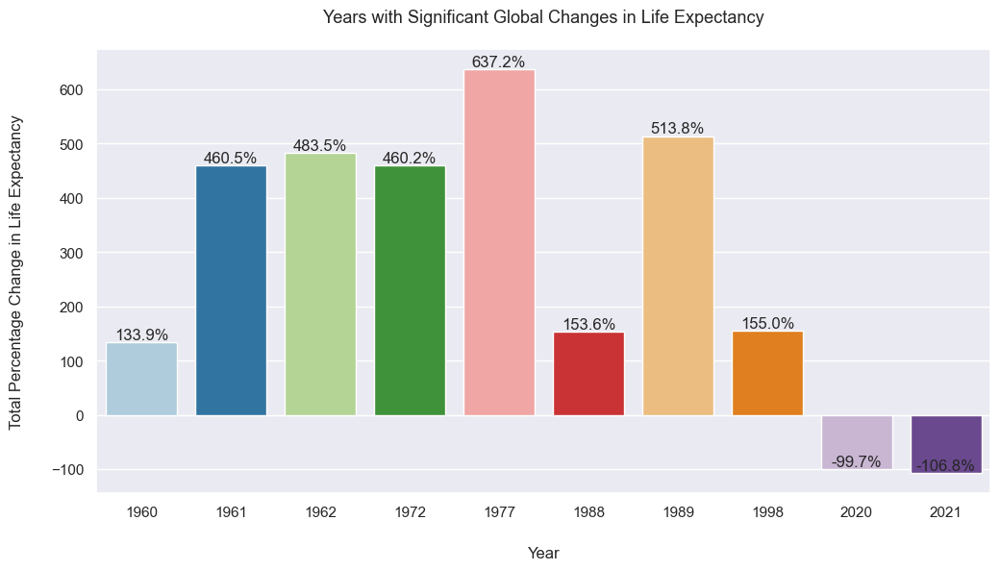

In [43]:
# Data to plot
df_melted = df_melted.sort_values(by=['Country Name', 'Year'])
df_melted['Life Expectancy Percentage Change'] = df_melted.groupby('Country Name', observed=False)['Life Expectancy'].pct_change() * 100
yearly_percentage_changes = df_melted.groupby('Year')['Life Expectancy Percentage Change'].sum().reset_index()

# Identify significant years (e.g., top 5 increases and decreases)
top_percentage_increases = yearly_percentage_changes.nlargest(5, 'Life Expectancy Percentage Change')
top_percentage_decreases = yearly_percentage_changes.nsmallest(5, 'Life Expectancy Percentage Change')
significant_percentage_years = pd.concat([top_percentage_increases, top_percentage_decreases])

# Bar plot to visualize significant percentage changes
plt.figure(figsize=(12, 6))
ax = sns.barplot(data=significant_percentage_years, x='Year', y='Life Expectancy Percentage Change', palette='Paired', hue='Year')
plt.title('Years with Significant Global Changes in Life Expectancy', pad=20, fontsize=13)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Total Percentage Change in Life Expectancy', labelpad=20)
for bar in ax.patches:
    height = bar.get_height()
    if height != 0:
        ax.annotate(f'{height:.1f}%',
                    (bar.get_x() + bar.get_width() / 2, height),
                    ha='center', va='bottom')
plt.legend([], [], frameon=False)
plt.show()

**INSIGHTS:**

An analysis of the years with the most significant changes in life expectancy reveals several key conclusions:

- During the 1960s and 1970s, there was a notable increase in life expectancy worldwide. This growth was especially pronounced in developing countries, which benefited from the adoption of improved health practices.

- The upward trend in life expectancy persisted into the late 1980s, driven by ongoing medical advancements and global health initiatives. These efforts further enhanced life expectancy across many regions.

- In 2020, life expectancy experienced its first significant decline since the 1960s due to the COVID-19 pandemic. The pandemic led to increased mortality rates, causing a temporary dip in life expectancy and marking a significant deviation from the long-term upward trend.

- Despite events like the pandemic, the general trend in life expectancy remains upward. Such significant events tend to have only a temporary impact on the overall positive trajectory of life expectancy improvements.

### 7.5 Life Expectancy Comparisons to Global Averages

***How does life expectancy in different regions compare to global averages?***

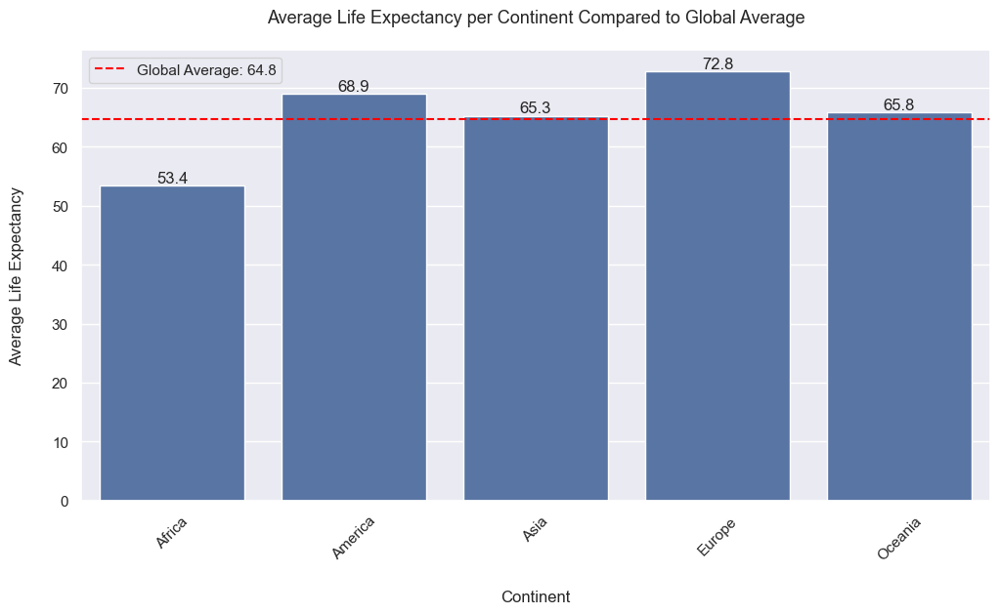

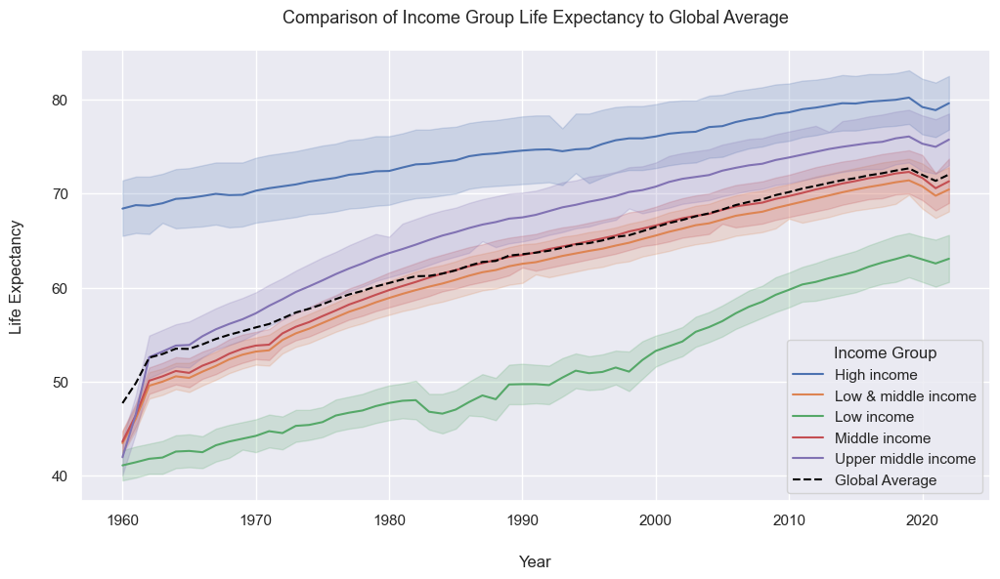

In [44]:
# VISUALIATION 1
# # Filter global and regional (World) average data
global_data = df_melted[df_melted['Country Name'] == 'World']
regional_data = df_melted[df_melted['Country Name'] != 'World']
combined_data = pd.concat([global_data, regional_data])

# Create an interactive line plot with Plotly
fig = px.line(combined_data,
              x='Year',
              y='Life Expectancy',
              color='Country Name',
              title='Comparison of Regional Life Expectancy to Global Averages')

# Ensure "World" is always visible
world_trace_index = combined_data['Country Name'].unique().tolist().index('World')

# Customize plot
fig.update_layout(
    xaxis_title='Year',
    yaxis_title='Life Expectancy',
    showlegend=True,
    updatemenus=[
        dict(
            type="buttons",
            direction="left",
            buttons=[
                dict(
                    label="Deselect All",
                    method="update",
                    args=[{"visible": [i == world_trace_index or "legendonly" for i in range(len(fig.data))]}]
                ),
                dict(
                    label="Select All",
                    method="update",
                    args=[{"visible": [True] * len(fig.data)}]
                )
            ],
            pad={"r": -180, "t": 10},
            showactive=False,
            x=1,
            xanchor="right",
            y=1.1,
            yanchor="top"
        ),
    ],
    height = 650,
    width = 1200,
    title={
        'x': 0.5,
        'xanchor': 'center'
    }
)
pio.show(fig)

# VISUALIATION 2
# Calculate average life expectancy per region
average_life_expectancy = df_with_regions.groupby('Region')['Life Expectancy'].mean().reset_index()
global_average = df_with_regions['Life Expectancy'].mean()

# Plotting the bar chart
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='Region', y='Life Expectancy', data=average_life_expectancy)
plt.axhline(global_average, color='red', linestyle='--', label=f'Global Average: {global_average:.1f}')
for bar in ax.patches:
    height = bar.get_height()
    ax.annotate(f'{height:.1f}',
                (bar.get_x() + bar.get_width() / 2, height),
                ha='center', va='bottom')
plt.title('Average Life Expectancy per Continent Compared to Global Average', pad=20, fontsize=13)
plt.xlabel('Continent', labelpad=20)
plt.ylabel('Average Life Expectancy', labelpad=20)
plt.xticks(rotation=45)
plt.legend()
plt.show()

# VISUALIATION 3
# Define the list of income groups
income_groups = [
    "Low income",
    "Low & middle income",
    "Middle income",
    "Upper middle income",
    "High income"
]
df_melted['Income Group'] = df_melted['Country Name'].apply(lambda x: x if x in income_groups else None)
filtered_data = df_melted[df_melted['Income Group'].notnull()]
average_life_expectancy = filtered_data.groupby('Year')['Life Expectancy'].mean().reset_index()

# Create a line plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=filtered_data, x='Year', y='Life Expectancy', hue='Income Group')
plt.plot(average_life_expectancy['Year'], average_life_expectancy['Life Expectancy'], color='black', linestyle='--', label='Global Average')
plt.title('Comparison of Income Group Life Expectancy to Global Average', pad=20, fontsize=13)
plt.xlabel('Year', labelpad=20)
plt.ylabel('Life Expectancy', labelpad=20)
plt.legend(title='Income Group')
plt.show()

**INSIGHTS:** 

An examination of regional average life expectancy in relation to global averages reveals several key points:

- Nations such as Zambia and Somalia in Africa have life expectancies significantly below the global average. This is largely due to issues like limited access to healthcare, poor nutrition, and inadequate infrastructure. These regions require targeted interventions to enhance health outcomes.

- Middle-income countries typically have life expectancies close to the global average, though they often fall slightly below. While these countries are experiencing improvements in healthcare and economic conditions, internal disparities can impact their overall life expectancy figures.

- High-income countries consistently surpass the global average life expectancy. This is attributed to advanced healthcare systems, superior living conditions, and greater economic stability, underscoring the positive effects of social and economic development on health outcomes.

<br>

<a id="Conclusion"></a>

## 8. Final Conclusion

Statistical tests have confirmed a positive trend in life expectancy over time across all regions, though there are a few notable outliers that deviate from this overall upward pattern. This indicates that, despite certain ongoing challenges in specific areas or time periods, global health has generally improved. These findings emphasize the ongoing need for targeted interventions to address regional disparities and gender differences in health outcomes.